# **READ ME**

**Main Libraries Used**


1.   PyTorch
2.   Matplotlib
3.   Numpy



**Style Image** : No. 5, 1948

**Content Image** : Hugh Jackman

**Model**: VGG19



In [19]:
#Importing All the Libraries
import torch
from torchvision import transforms, models
from PIL import Image
import matplotlib.pyplot as plt
import numpy as np

In [20]:
# Checking if CUDA is available and setting device accordingly
device = ("cuda" if torch.cuda.is_available() else "cpu")

In [21]:
# Load the VGG19 model and freeze parameters
model = models.vgg19(pretrained=True).features
for p in model.parameters():
    p.requires_grad = False
model.to(device)

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG19_Weights.IMAGENET1K_V1`. You can also use `weights=VGG19_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/vgg19-dcbb9e9d.pth" to /root/.cache/torch/hub/checkpoints/vgg19-dcbb9e9d.pth
100%|██████████| 548M/548M [00:08<00:00, 67.4MB/s]


Sequential(
  (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (1): ReLU(inplace=True)
  (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (3): ReLU(inplace=True)
  (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (6): ReLU(inplace=True)
  (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (8): ReLU(inplace=True)
  (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (11): ReLU(inplace=True)
  (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (13): ReLU(inplace=True)
  (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (15): ReLU(inplace=True)
  (16): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (17): ReLU(inplace=True)
  (18): MaxPoo

In [22]:
# Function to extract activations from specified layers of the model only
def model_activations(input, model):
    layers = {
        #only the layer numbers mentioned are taken
        '0' : 'conv1_1',
        '5' : 'conv2_1',
        '10': 'conv3_1',
        '19': 'conv4_1',
        '21': 'conv4_2',
        '28': 'conv5_1'
    }
    features = {}
    x = input
    x = x.unsqueeze(0)
    for name, layer in model._modules.items():
        x = layer(x)
        if name in layers:
            features[layers[name]] = x

    return features

In [23]:
# Image transformations for content and style images
transform = transforms.Compose([
    transforms.Resize(300),
    transforms.ToTensor(),
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))
])

In [24]:
# Loading content and style images
content = Image.open("/content/OzdkEUD-wallpaper-of-hugh-jackman.jpg").convert("RGB")
content = transform(content).to(device)
print("Content shape => ", content.shape)

style = Image.open("/content/wp1939198-pollok-wallpapers.jpg").convert("RGB")
style = transform(style).to(device)

Content shape =>  torch.Size([3, 300, 449])


In [25]:
# Function to convert PyTorch tensor to numpy array for visualization
def imcnvt(image):
    x = image.to("cpu").clone().detach().numpy().squeeze()
    x = x.transpose(1, 2, 0)
    x = x * np.array((0.5, 0.5, 0.5)) + np.array((0.5, 0.5, 0.5))
    return np.clip(x, 0, 1)

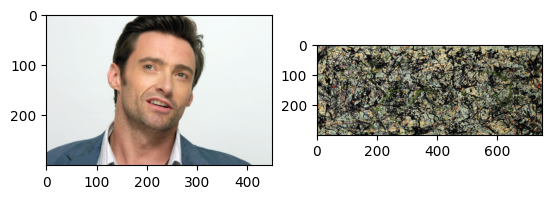

In [26]:
# Displaying content and style images
fig, (ax1, ax2) = plt.subplots(1, 2)
ax1.imshow(imcnvt(content), label="Content")
ax2.imshow(imcnvt(style), label="Style")
plt.show()

In [27]:
# Function to compute Gram matrix
def gram_matrix(imgfeature):
    _, d, h, w = imgfeature.size()
    imgfeature = imgfeature.view(d, h * w)
    gram_mat = torch.mm(imgfeature, imgfeature.t())
    return gram_mat

# Creating a target image for optimization
target = content.clone().requires_grad_(True).to(device)

# Printing device information
print("Device = ", device)

# Extracting features for style and content images
style_features = model_activations(style, model)
content_features = model_activations(content, model)

Device =  cuda


In [31]:
# Defining style weights for different layers (priviously Selected ones)
style_wt_meas = {"conv1_1": 1.0,
                 "conv2_1": 0.8,
                 "conv3_1": 0.4,
                 "conv4_1": 0.2,
                 "conv5_1": 0.1}

style_grams = {layer:gram_matrix(style_features[layer]) for layer in style_features}

# Seting content and style weights
content_wt = 100
style_wt = 1e8



In [ ]:
# Print loss after specified number of iterations
print_after = 100
epochs = 1000
optimizer = torch.optim.Adam([target], lr=0.007)

Epoch  10  Loss:  tensor(1.1343e+11, device='cuda:0', grad_fn=<AddBackward0>)
Epoch  20  Loss:  tensor(7.6322e+10, device='cuda:0', grad_fn=<AddBackward0>)
Epoch  30  Loss:  tensor(5.2530e+10, device='cuda:0', grad_fn=<AddBackward0>)
Epoch  40  Loss:  tensor(3.8341e+10, device='cuda:0', grad_fn=<AddBackward0>)
Epoch  50  Loss:  tensor(2.8498e+10, device='cuda:0', grad_fn=<AddBackward0>)
Epoch  60  Loss:  tensor(2.1543e+10, device='cuda:0', grad_fn=<AddBackward0>)
Epoch  70  Loss:  tensor(1.6626e+10, device='cuda:0', grad_fn=<AddBackward0>)
Epoch  80  Loss:  tensor(1.3111e+10, device='cuda:0', grad_fn=<AddBackward0>)
Epoch  90  Loss:  tensor(1.0570e+10, device='cuda:0', grad_fn=<AddBackward0>)
Epoch  100  Loss:  tensor(8.7026e+09, device='cuda:0', grad_fn=<AddBackward0>)


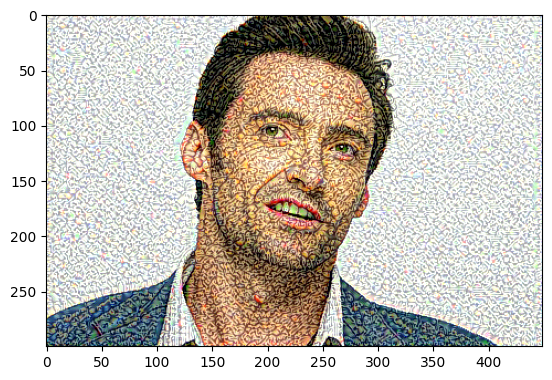

Epoch  110  Loss:  tensor(7.3088e+09, device='cuda:0', grad_fn=<AddBackward0>)
Epoch  120  Loss:  tensor(6.2500e+09, device='cuda:0', grad_fn=<AddBackward0>)
Epoch  130  Loss:  tensor(5.4302e+09, device='cuda:0', grad_fn=<AddBackward0>)
Epoch  140  Loss:  tensor(4.7832e+09, device='cuda:0', grad_fn=<AddBackward0>)
Epoch  150  Loss:  tensor(4.2619e+09, device='cuda:0', grad_fn=<AddBackward0>)
Epoch  160  Loss:  tensor(3.8340e+09, device='cuda:0', grad_fn=<AddBackward0>)
Epoch  170  Loss:  tensor(3.4777e+09, device='cuda:0', grad_fn=<AddBackward0>)
Epoch  180  Loss:  tensor(3.1775e+09, device='cuda:0', grad_fn=<AddBackward0>)
Epoch  190  Loss:  tensor(2.9220e+09, device='cuda:0', grad_fn=<AddBackward0>)
Epoch  200  Loss:  tensor(2.7023e+09, device='cuda:0', grad_fn=<AddBackward0>)


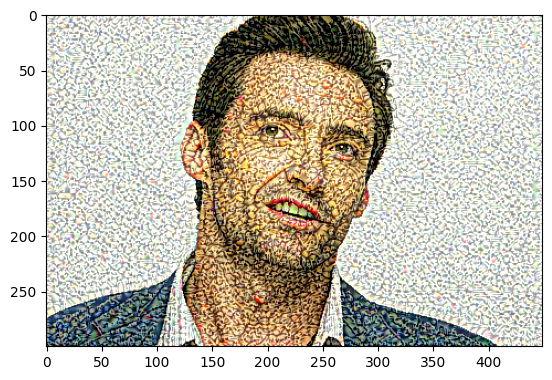

Epoch  210  Loss:  tensor(2.5118e+09, device='cuda:0', grad_fn=<AddBackward0>)
Epoch  220  Loss:  tensor(2.3452e+09, device='cuda:0', grad_fn=<AddBackward0>)
Epoch  230  Loss:  tensor(2.1988e+09, device='cuda:0', grad_fn=<AddBackward0>)
Epoch  240  Loss:  tensor(2.0694e+09, device='cuda:0', grad_fn=<AddBackward0>)
Epoch  250  Loss:  tensor(1.9548e+09, device='cuda:0', grad_fn=<AddBackward0>)
Epoch  260  Loss:  tensor(1.8527e+09, device='cuda:0', grad_fn=<AddBackward0>)
Epoch  270  Loss:  tensor(1.7614e+09, device='cuda:0', grad_fn=<AddBackward0>)
Epoch  280  Loss:  tensor(1.6794e+09, device='cuda:0', grad_fn=<AddBackward0>)
Epoch  290  Loss:  tensor(1.6053e+09, device='cuda:0', grad_fn=<AddBackward0>)
Epoch  300  Loss:  tensor(1.5381e+09, device='cuda:0', grad_fn=<AddBackward0>)


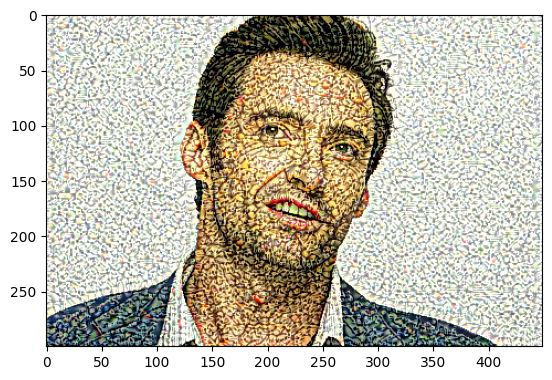

Epoch  310  Loss:  tensor(1.4769e+09, device='cuda:0', grad_fn=<AddBackward0>)
Epoch  320  Loss:  tensor(1.4210e+09, device='cuda:0', grad_fn=<AddBackward0>)
Epoch  330  Loss:  tensor(1.3699e+09, device='cuda:0', grad_fn=<AddBackward0>)
Epoch  340  Loss:  tensor(1.3231e+09, device='cuda:0', grad_fn=<AddBackward0>)
Epoch  350  Loss:  tensor(1.2801e+09, device='cuda:0', grad_fn=<AddBackward0>)
Epoch  360  Loss:  tensor(1.2404e+09, device='cuda:0', grad_fn=<AddBackward0>)
Epoch  370  Loss:  tensor(1.2039e+09, device='cuda:0', grad_fn=<AddBackward0>)
Epoch  380  Loss:  tensor(1.1700e+09, device='cuda:0', grad_fn=<AddBackward0>)
Epoch  390  Loss:  tensor(1.1385e+09, device='cuda:0', grad_fn=<AddBackward0>)
Epoch  400  Loss:  tensor(1.1091e+09, device='cuda:0', grad_fn=<AddBackward0>)


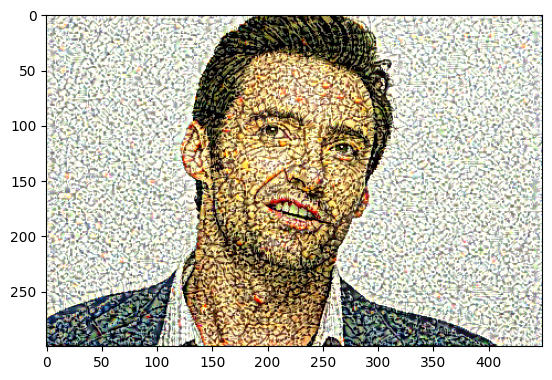

Epoch  410  Loss:  tensor(1.0817e+09, device='cuda:0', grad_fn=<AddBackward0>)
Epoch  420  Loss:  tensor(1.0561e+09, device='cuda:0', grad_fn=<AddBackward0>)
Epoch  430  Loss:  tensor(1.0322e+09, device='cuda:0', grad_fn=<AddBackward0>)
Epoch  440  Loss:  tensor(1.0096e+09, device='cuda:0', grad_fn=<AddBackward0>)
Epoch  450  Loss:  tensor(9.8840e+08, device='cuda:0', grad_fn=<AddBackward0>)
Epoch  460  Loss:  tensor(9.6840e+08, device='cuda:0', grad_fn=<AddBackward0>)
Epoch  470  Loss:  tensor(9.4949e+08, device='cuda:0', grad_fn=<AddBackward0>)
Epoch  480  Loss:  tensor(9.3159e+08, device='cuda:0', grad_fn=<AddBackward0>)
Epoch  490  Loss:  tensor(9.1461e+08, device='cuda:0', grad_fn=<AddBackward0>)
Epoch  500  Loss:  tensor(8.9848e+08, device='cuda:0', grad_fn=<AddBackward0>)


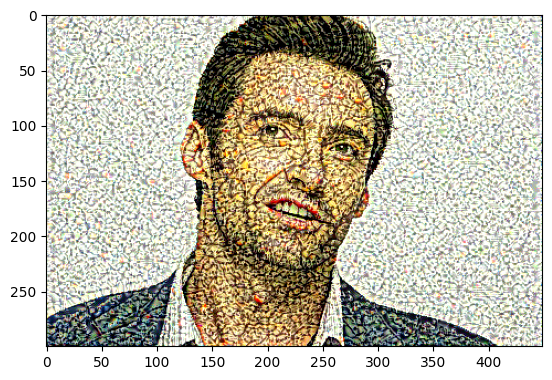

Epoch  510  Loss:  tensor(8.8315e+08, device='cuda:0', grad_fn=<AddBackward0>)
Epoch  520  Loss:  tensor(8.6856e+08, device='cuda:0', grad_fn=<AddBackward0>)
Epoch  530  Loss:  tensor(8.5465e+08, device='cuda:0', grad_fn=<AddBackward0>)
Epoch  540  Loss:  tensor(8.4137e+08, device='cuda:0', grad_fn=<AddBackward0>)
Epoch  550  Loss:  tensor(8.2867e+08, device='cuda:0', grad_fn=<AddBackward0>)
Epoch  560  Loss:  tensor(8.1651e+08, device='cuda:0', grad_fn=<AddBackward0>)
Epoch  570  Loss:  tensor(8.0485e+08, device='cuda:0', grad_fn=<AddBackward0>)
Epoch  580  Loss:  tensor(7.9367e+08, device='cuda:0', grad_fn=<AddBackward0>)
Epoch  590  Loss:  tensor(7.8293e+08, device='cuda:0', grad_fn=<AddBackward0>)
Epoch  600  Loss:  tensor(7.7261e+08, device='cuda:0', grad_fn=<AddBackward0>)


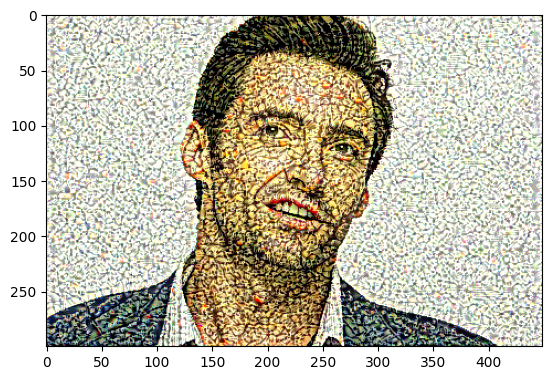

Epoch  610  Loss:  tensor(7.6266e+08, device='cuda:0', grad_fn=<AddBackward0>)
Epoch  620  Loss:  tensor(7.5307e+08, device='cuda:0', grad_fn=<AddBackward0>)
Epoch  630  Loss:  tensor(7.4382e+08, device='cuda:0', grad_fn=<AddBackward0>)
Epoch  640  Loss:  tensor(7.3489e+08, device='cuda:0', grad_fn=<AddBackward0>)
Epoch  650  Loss:  tensor(7.2625e+08, device='cuda:0', grad_fn=<AddBackward0>)
Epoch  660  Loss:  tensor(7.1790e+08, device='cuda:0', grad_fn=<AddBackward0>)
Epoch  670  Loss:  tensor(7.0983e+08, device='cuda:0', grad_fn=<AddBackward0>)
Epoch  680  Loss:  tensor(7.0199e+08, device='cuda:0', grad_fn=<AddBackward0>)
Epoch  690  Loss:  tensor(6.9439e+08, device='cuda:0', grad_fn=<AddBackward0>)
Epoch  700  Loss:  tensor(6.8702e+08, device='cuda:0', grad_fn=<AddBackward0>)


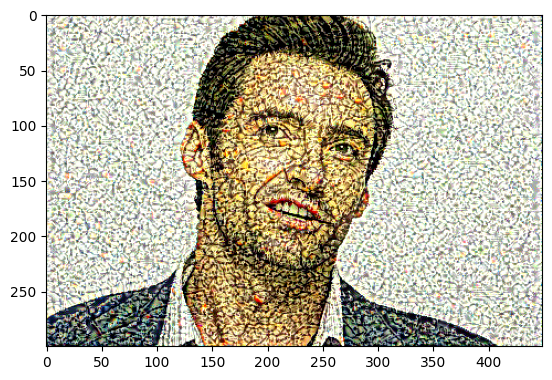

Epoch  710  Loss:  tensor(6.7986e+08, device='cuda:0', grad_fn=<AddBackward0>)
Epoch  720  Loss:  tensor(6.7290e+08, device='cuda:0', grad_fn=<AddBackward0>)
Epoch  730  Loss:  tensor(6.6613e+08, device='cuda:0', grad_fn=<AddBackward0>)
Epoch  740  Loss:  tensor(6.5955e+08, device='cuda:0', grad_fn=<AddBackward0>)
Epoch  750  Loss:  tensor(6.5314e+08, device='cuda:0', grad_fn=<AddBackward0>)
Epoch  760  Loss:  tensor(6.4690e+08, device='cuda:0', grad_fn=<AddBackward0>)
Epoch  770  Loss:  tensor(6.4080e+08, device='cuda:0', grad_fn=<AddBackward0>)
Epoch  780  Loss:  tensor(6.3486e+08, device='cuda:0', grad_fn=<AddBackward0>)
Epoch  790  Loss:  tensor(6.2906e+08, device='cuda:0', grad_fn=<AddBackward0>)
Epoch  800  Loss:  tensor(6.2339e+08, device='cuda:0', grad_fn=<AddBackward0>)


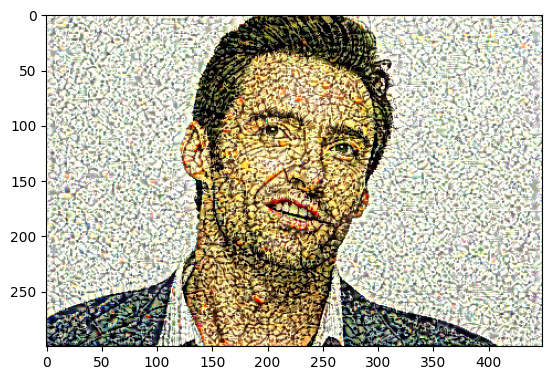

Epoch  810  Loss:  tensor(6.1785e+08, device='cuda:0', grad_fn=<AddBackward0>)
Epoch  820  Loss:  tensor(6.1244e+08, device='cuda:0', grad_fn=<AddBackward0>)
Epoch  830  Loss:  tensor(6.0715e+08, device='cuda:0', grad_fn=<AddBackward0>)
Epoch  840  Loss:  tensor(6.0197e+08, device='cuda:0', grad_fn=<AddBackward0>)
Epoch  850  Loss:  tensor(5.9690e+08, device='cuda:0', grad_fn=<AddBackward0>)
Epoch  860  Loss:  tensor(5.9195e+08, device='cuda:0', grad_fn=<AddBackward0>)
Epoch  870  Loss:  tensor(5.8710e+08, device='cuda:0', grad_fn=<AddBackward0>)
Epoch  880  Loss:  tensor(5.8235e+08, device='cuda:0', grad_fn=<AddBackward0>)
Epoch  890  Loss:  tensor(5.7770e+08, device='cuda:0', grad_fn=<AddBackward0>)
Epoch  900  Loss:  tensor(5.7315e+08, device='cuda:0', grad_fn=<AddBackward0>)


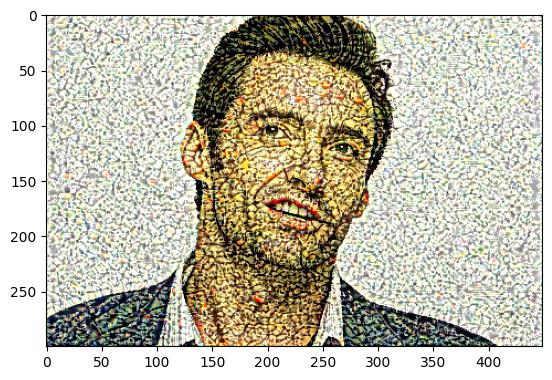

Epoch  910  Loss:  tensor(5.6868e+08, device='cuda:0', grad_fn=<AddBackward0>)
Epoch  920  Loss:  tensor(5.6430e+08, device='cuda:0', grad_fn=<AddBackward0>)
Epoch  930  Loss:  tensor(5.6001e+08, device='cuda:0', grad_fn=<AddBackward0>)
Epoch  940  Loss:  tensor(5.5579e+08, device='cuda:0', grad_fn=<AddBackward0>)
Epoch  950  Loss:  tensor(5.5165e+08, device='cuda:0', grad_fn=<AddBackward0>)
Epoch  960  Loss:  tensor(5.4758e+08, device='cuda:0', grad_fn=<AddBackward0>)
Epoch  970  Loss:  tensor(5.4360e+08, device='cuda:0', grad_fn=<AddBackward0>)
Epoch  980  Loss:  tensor(5.3968e+08, device='cuda:0', grad_fn=<AddBackward0>)
Epoch  990  Loss:  tensor(5.3583e+08, device='cuda:0', grad_fn=<AddBackward0>)
Epoch  1000  Loss:  tensor(5.3204e+08, device='cuda:0', grad_fn=<AddBackward0>)


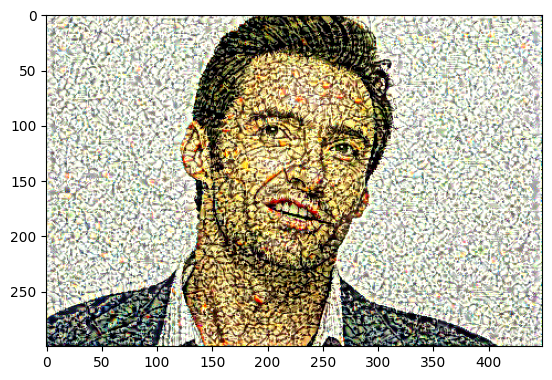

In [32]:
#iteration of epochs
for i in range(1, epochs + 1):
    target_features = model_activations(target, model)
    content_loss = torch.mean((content_features['conv4_2'] - target_features['conv4_2'])**2)

    style_loss = 0
    for layer in style_wt_meas:
        style_gram = style_grams[layer]
        target_gram = target_features[layer]
        _, d, w, h = target_gram.shape
        target_gram = gram_matrix(target_gram)

        style_loss += (style_wt_meas[layer] * torch.mean((target_gram - style_gram)**2)) / (d * w * h)

    total_loss = content_wt * content_loss + style_wt * style_loss

    if i % 10 == 0:
        print("Epoch ", i, " Loss: ", total_loss)

    optimizer.zero_grad()
    total_loss.backward()
    optimizer.step()

    if i % print_after == 0:
        plt.imshow(imcnvt(target), label="Epoch " + str(i))
        plt.show()
        plt.imsave(str(i) + '.png', imcnvt(target), format='png')


In [33]:
#increasing the number of epochs (1000 to 11000)
print_after = 500
epochs = 10000
optimizer = torch.optim.Adam([target], lr=0.007)

Epoch  250  Loss:  tensor(1.4077e+08, device='cuda:0', grad_fn=<AddBackward0>)
Epoch  500  Loss:  tensor(1.1193e+08, device='cuda:0', grad_fn=<AddBackward0>)


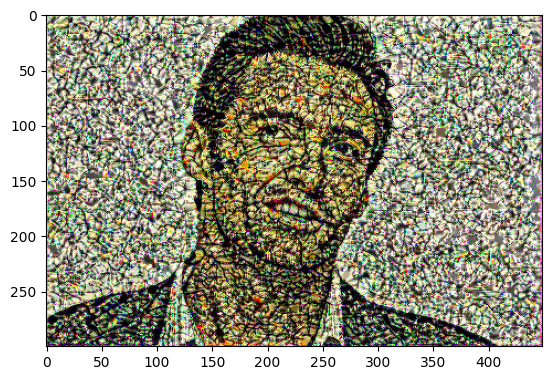

Epoch  750  Loss:  tensor(99434128., device='cuda:0', grad_fn=<AddBackward0>)
Epoch  1000  Loss:  tensor(92172400., device='cuda:0', grad_fn=<AddBackward0>)


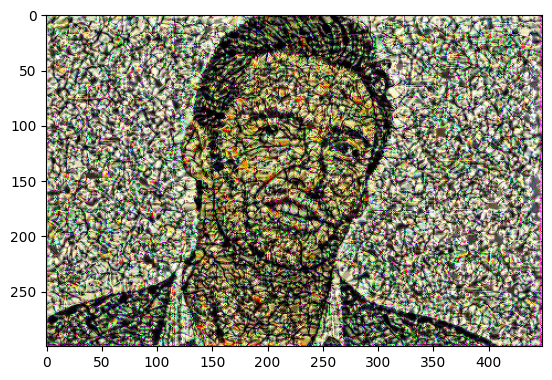

Epoch  1250  Loss:  tensor(87483512., device='cuda:0', grad_fn=<AddBackward0>)
Epoch  1500  Loss:  tensor(84141152., device='cuda:0', grad_fn=<AddBackward0>)


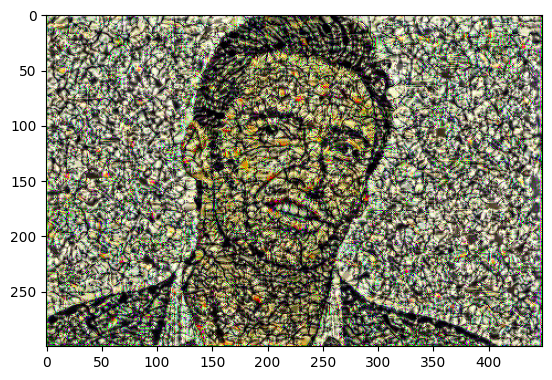

Epoch  1750  Loss:  tensor(81386712., device='cuda:0', grad_fn=<AddBackward0>)
Epoch  2000  Loss:  tensor(79266640., device='cuda:0', grad_fn=<AddBackward0>)


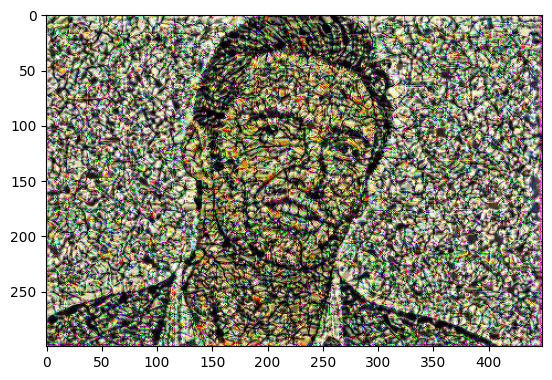

Epoch  2250  Loss:  tensor(77759776., device='cuda:0', grad_fn=<AddBackward0>)
Epoch  2500  Loss:  tensor(76410008., device='cuda:0', grad_fn=<AddBackward0>)


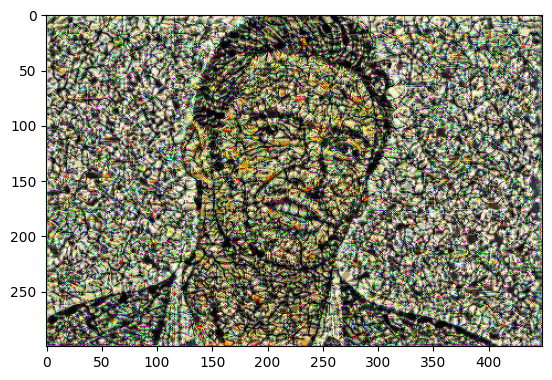

Epoch  2750  Loss:  tensor(75004608., device='cuda:0', grad_fn=<AddBackward0>)
Epoch  3000  Loss:  tensor(73866496., device='cuda:0', grad_fn=<AddBackward0>)


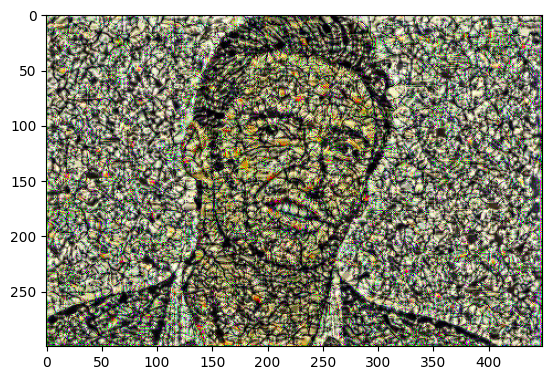

Epoch  3250  Loss:  tensor(73019032., device='cuda:0', grad_fn=<AddBackward0>)
Epoch  3500  Loss:  tensor(72444384., device='cuda:0', grad_fn=<AddBackward0>)


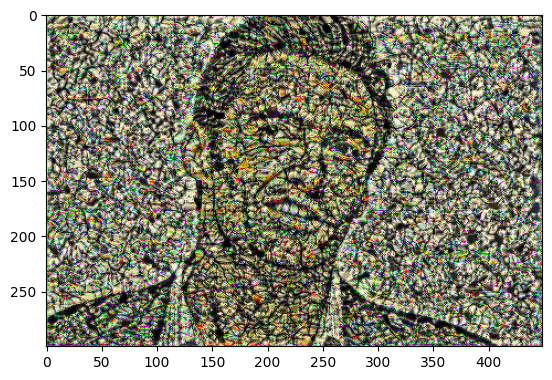

Epoch  3750  Loss:  tensor(71433544., device='cuda:0', grad_fn=<AddBackward0>)
Epoch  4000  Loss:  tensor(70815552., device='cuda:0', grad_fn=<AddBackward0>)


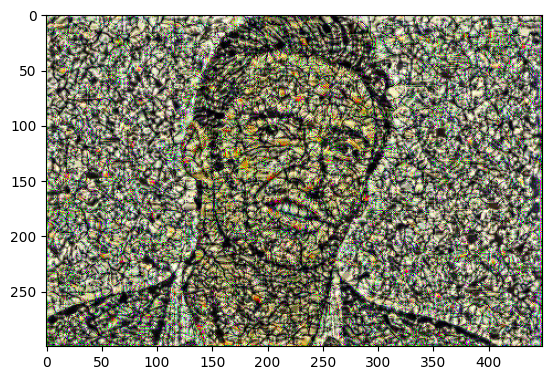

Epoch  4250  Loss:  tensor(70234400., device='cuda:0', grad_fn=<AddBackward0>)
Epoch  4500  Loss:  tensor(69613648., device='cuda:0', grad_fn=<AddBackward0>)


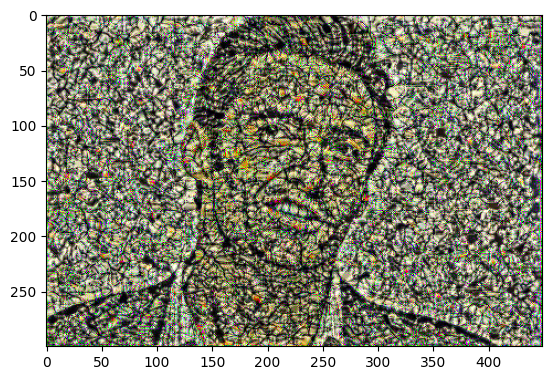

Epoch  4750  Loss:  tensor(69101312., device='cuda:0', grad_fn=<AddBackward0>)
Epoch  5000  Loss:  tensor(68634944., device='cuda:0', grad_fn=<AddBackward0>)


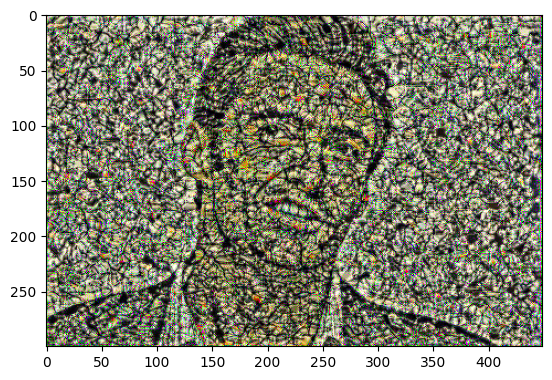

Epoch  5250  Loss:  tensor(68126056., device='cuda:0', grad_fn=<AddBackward0>)
Epoch  5500  Loss:  tensor(67715944., device='cuda:0', grad_fn=<AddBackward0>)


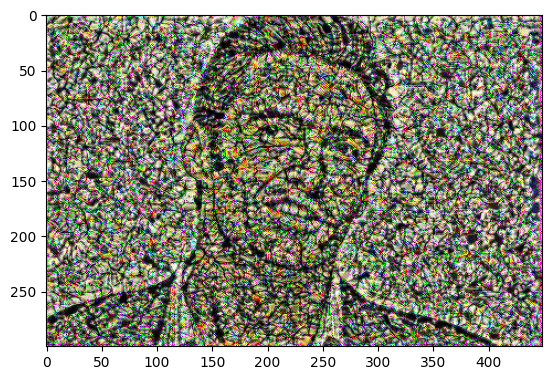

Epoch  5750  Loss:  tensor(67271128., device='cuda:0', grad_fn=<AddBackward0>)
Epoch  6000  Loss:  tensor(67028644., device='cuda:0', grad_fn=<AddBackward0>)


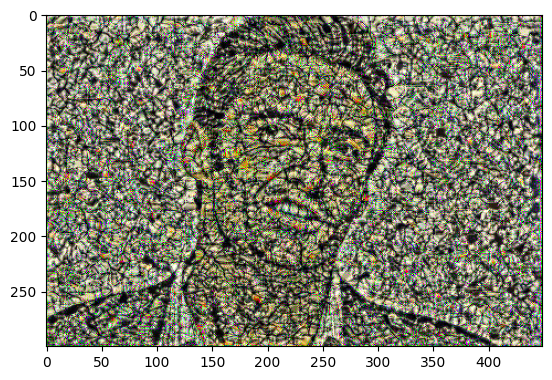

Epoch  6250  Loss:  tensor(66678100., device='cuda:0', grad_fn=<AddBackward0>)
Epoch  6500  Loss:  tensor(66317664., device='cuda:0', grad_fn=<AddBackward0>)


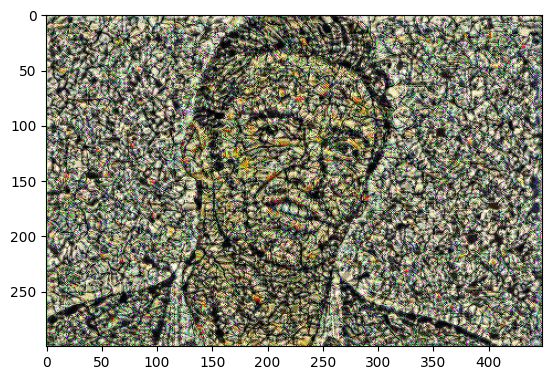

Epoch  6750  Loss:  tensor(65948584., device='cuda:0', grad_fn=<AddBackward0>)
Epoch  7000  Loss:  tensor(65719984., device='cuda:0', grad_fn=<AddBackward0>)


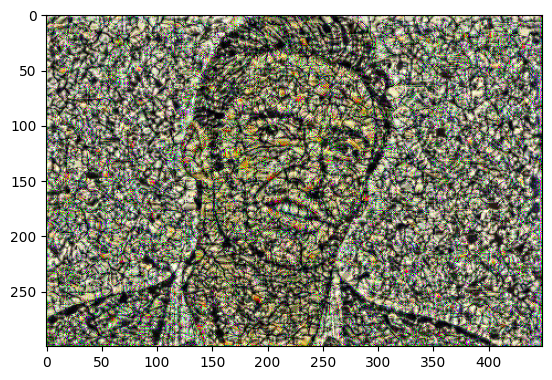

Epoch  7250  Loss:  tensor(65446312., device='cuda:0', grad_fn=<AddBackward0>)
Epoch  7500  Loss:  tensor(65178936., device='cuda:0', grad_fn=<AddBackward0>)


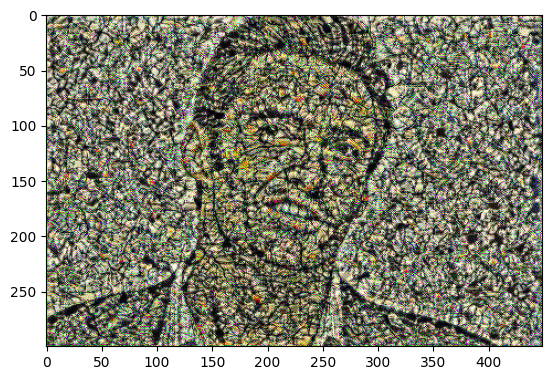

Epoch  7750  Loss:  tensor(65017076., device='cuda:0', grad_fn=<AddBackward0>)
Epoch  8000  Loss:  tensor(64625796., device='cuda:0', grad_fn=<AddBackward0>)


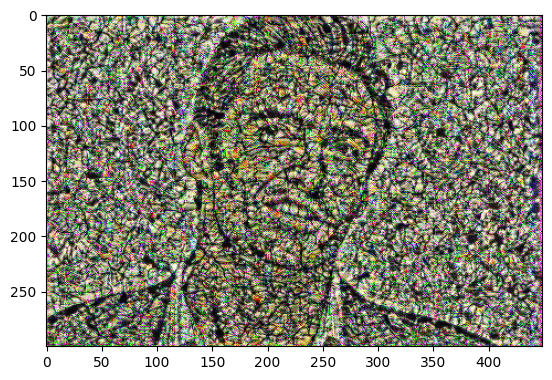

Epoch  8250  Loss:  tensor(64383452., device='cuda:0', grad_fn=<AddBackward0>)
Epoch  8500  Loss:  tensor(64257616., device='cuda:0', grad_fn=<AddBackward0>)


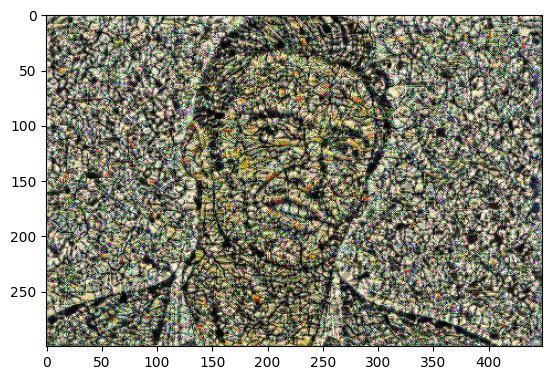

Epoch  8750  Loss:  tensor(64043200., device='cuda:0', grad_fn=<AddBackward0>)
Epoch  9000  Loss:  tensor(63979544., device='cuda:0', grad_fn=<AddBackward0>)


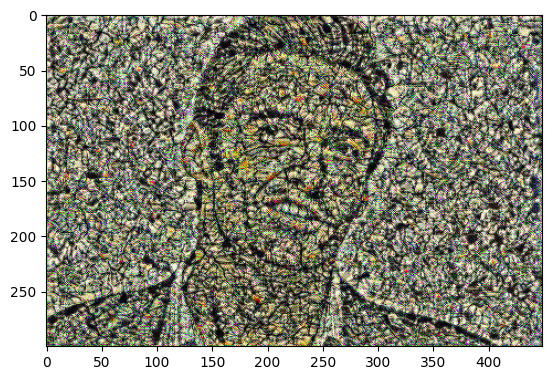

Epoch  9250  Loss:  tensor(63578512., device='cuda:0', grad_fn=<AddBackward0>)
Epoch  9500  Loss:  tensor(63706800., device='cuda:0', grad_fn=<AddBackward0>)


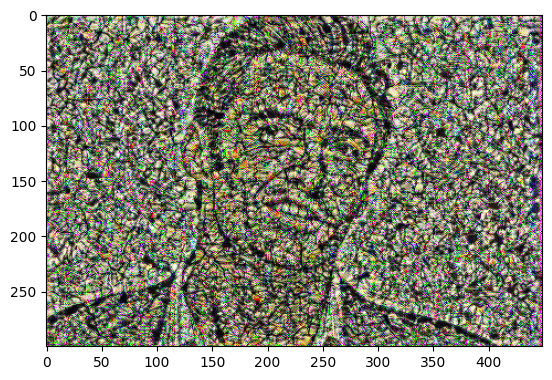

Epoch  9750  Loss:  tensor(63243696., device='cuda:0', grad_fn=<AddBackward0>)
Epoch  10000  Loss:  tensor(63005164., device='cuda:0', grad_fn=<AddBackward0>)


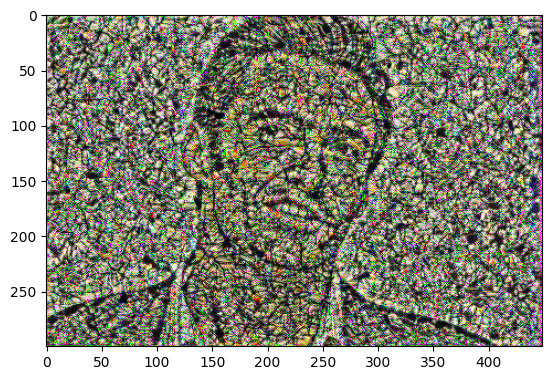

In [35]:
for i in range(1, epochs + 1):
    target_features = model_activations(target, model)
    content_loss = torch.mean((content_features['conv4_2'] - target_features['conv4_2'])**2)

    style_loss = 0
    for layer in style_wt_meas:
        style_gram = style_grams[layer]
        target_gram = target_features[layer]
        _, d, w, h = target_gram.shape
        target_gram = gram_matrix(target_gram)

        style_loss += (style_wt_meas[layer] * torch.mean((target_gram - style_gram)**2)) / (d * w * h)

    total_loss = content_wt * content_loss + style_wt * style_loss

    if i % 250 == 0:
        print("Epoch ", i, " Loss: ", total_loss)

    optimizer.zero_grad()
    total_loss.backward()
    optimizer.step()

    if i % print_after == 0:
        plt.imshow(imcnvt(target), label="Epoch " + str(i))
        plt.show()
        plt.imsave(str(i) + '.png', imcnvt(target), format='png')


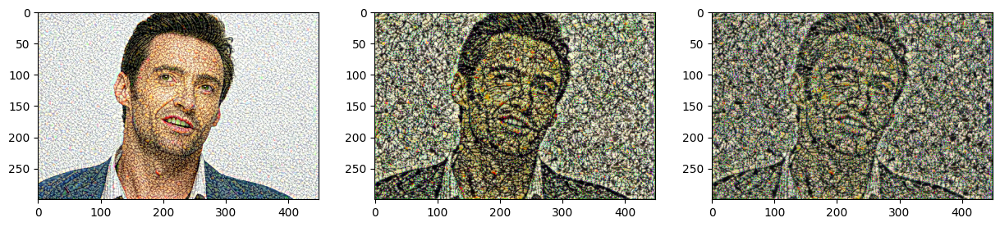

In [42]:
# Displaying 100 epoch image, 1000 epoch image and 11000 epoch images

fig = plt.figure(figsize=(15, 5))  # Seting the size of the figure

image_100_epoch = Image.open("/content/100.png").convert("RGB")
image_100_epoch = transform(image_100_epoch).to(device)

image_1000_epoch = Image.open("/content/1000.png").convert("RGB")
image_1000_epoch = transform(image_1000_epoch).to(device)

image_11000_epoch = Image.open("/content/10000.png").convert("RGB")
image_11000_epoch = transform(image_11000_epoch).to(device)

ax1 = fig.add_subplot(1, 3, 1)
ax1.imshow(imcnvt(image_100_epoch), label="100 epoch image")

ax2 = fig.add_subplot(1, 3, 2)
ax2.imshow(imcnvt(image_1000_epoch), label="1000 epoch image")

ax3 = fig.add_subplot(1, 3, 3)
ax3.imshow(imcnvt(image_11000_epoch), label="11000 epoch image")

plt.show()


**Conclusion**  As we increase the number of epoch the tendency of the image generated tends to move more towards the style image keeping the epoch between 500 to 800 is the best.


Submitted by:
Shaikh Mohammed Farman




Roll no:
19ME33007